### Buckley-Leverett

This notebook aims to generate a PINN (_Physics Informed Neural Network_) for solving the _Buckley-Leverett_ equation and compare its result with the analytical solution.
 
_Buckley-Leverett_ is a conservation equation used to model two-phase flow in porous media and can be treated as solving the Partial Differential Equation (PDE):
 
<center>$u_t+(f_w)_x=0$</center>


We will consider the case of the non-convex flow function:

<center><h2>$f_w = \frac{u^2}{u^2+ \frac{(1-u)^2}{M}}$</h2></center>


where $M$ is the ratio between the viscosities we consider to be $1$ and with the following initial boundary conditions:

$u(x,t)=0,\space ∀x \space$ and $t=0$

$u(x,t)=1,\space x=0 \space$ and $t>0$

with $x \in [0,1] $ and $t \in [0,1]$.

This configuration follows the pattern indicated in the study article [1] in item 4.2.

For PINN we used the SimulAI tool developed by IBM [2].

$\space$


## References
 
[1] Fuks, Olga and Tchelepi, Hamdi A. "Limitations of physics informed machine learning for nonlinear two-phase transport in porous media." Journal of Machine Learning for Modeling and Computing 1.1 (2020).
 
[2] IBM. SimulAI Toolkit: A Python Package with Data-Driven Pipelines for Physics-Informed Machine Learning. 2022, doi:10.5281/zenodo.7351516.

[3] Lie, Henrik Syversveen. TMA4212 Buckley-Leverett report. Personal GitHub. Avaliable in: https://github.com/henrisli/Buckley-Leverett/blob/master/TMA4212%20Buckley-Leverett%20report.pdf. Accessed in: 06 Apr 2023.

## Authors

*  Nicole Pan Tavares (nicoleptav@gmail.com)
*  Wilson Bagni Junior (www.ic.unicamp.br/~wbagni)

## Code

In [1]:
# This code is designed to be used in the Google 
# Colaboratory environment (https://colab.research.google.com/). Adjustments may 
# be made to run it in other environments 

# Installing the SimulAI tool

!pip install simulai-toolkit -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.2/214.2 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.2/77.2 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.7/365.7 kB 22.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 MB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.9/212.9 kB 18.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 3.5 MB/s eta 0:00:00


In [1]:
# Imports that will be used during code execution

#%%capture 

import sympy as sp
import numpy as np
import torch
import matplotlib.pyplot as plt
from simulai.optimization import Optimizer
from simulai.residuals import SymbolicOperator

# Imports to neural network
from simulai.models import ImprovedDenseNetwork
from simulai.regression import SLFNN, ConvexDenseNetwork, DenseNetwork
from simulai.tokens import D

# Imports for visualization and animation
from matplotlib import animation, rc
from IPython.display import HTML 

# Setting seed to aid reproducibility
np.random.seed(1234)

### Analytical Solution

For the configuration shown, we can use the following analytical solution [3] below considering that $ξ= x/t$:



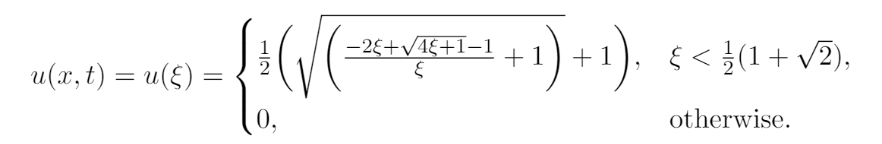

At the end of the execution of the code below we will have a $u\_n$ matrix of dimensions $(nt,nx)$, composed of $nt$ measurements in time and $nx$ measurements in space that make up the chosen _grid_.

In [3]:
# Solution parameters and dataset building

nx = 401  # Number of points to be plotted
dx = 1./(nx-1) # Distance between each plotted point
nt = 301  # Number of points in which the time will be divided (snapshots)
dt = 1./(nt-1)  # Time between snapshots


def u_analytic(x,t):
  u_value = 0
  if t == 0:
    u_value = 0
  elif x == 0 and t > 0:
    u_value = 1
  elif x < (1/2)*(1+np.sqrt(2))*t:
    e = x/t
    u_value = (1/2)*(np.sqrt((-2*e+np.sqrt(4*e+1)-1)/e +1)+1)
 
  return u_value

u_n = np.zeros((nt,nx)) # Matrix of nt rows and nx columns
for i in range(nt):
    for j in range(nx):
          u_n[i,j] = u_analytic(j*dx, i*dt)


### PINN - General Definitions

In [4]:
# Parameter Setting

N = 10_000 
n = 100
T_max = 1
x_max = 1

x, t, u = sp.symbols('x t u')

g_1 = 'u-1' # Boundary condition

# Constant
M =1

In [5]:
# Network Parameter Settings

input_labels = [x, t]
output_labels = [u]
n_inputs = len(input_labels)
n_outputs = len(output_labels)
n_epochs = 50000 
lr = 1e-3 

boundary_penalties = [1]
weights_residual =  [1]
initial_penalty = 1


In [6]:
# PDE training and test set definition
x_eval = (np.random.rand(N) * x_max)[:, None]
time_eval = (np.random.rand(N) * T_max)[:, None]

# Regular grid
X_DIM = 100
T_DIM = 100

dx = (x_max) / X_DIM
dt_ = (T_max) / T_DIM

grid = np.mgrid[dt_ : T_max + dt_ : dt_, 0:x_max:dx]

X_train = np.hstack([grid[1].flatten()[:, None], grid[0].flatten()[:, None]])

In [7]:
# Dataset Definition for Initial Condition
# u=0 at t=0 for any x

x_init = np.linspace(0, x_max, 3*n)[:, None]
t_init = np.zeros(3*n)[:, None]

data_initial = np.hstack([x_init, t_init])

u_initial = np.zeros(3*n)[:, None]

In [8]:
# Data definition for boundary condition
# For t>0, u=1 for x=0.

x_bc = np.zeros(3*n)[:, None] 
t_bc = np.linspace(1e-8, T_max, 3*n)[:, None]

data_bc = np.hstack([x_bc, t_bc])


In [9]:
# Setting the function that will build the training net
# It is possible to choose two different types of nets

def model(net_type="Dense"):

  # If it is a fully connected network
 
  if net_type=="Dense":

    # Configuration for fully connected network
    config = {
        "layers_units": 6*[128],
        #"layers_units": [356,128,64,128,356],
        "activations": "tanh",
        "input_size": 2,
        "output_size": 1,
        "name": "net",
    }

    # Instantiating and training the surrogate model
    net = DenseNetwork(**config)

    return net

  # If you want to use the ImprovedDenseNetwork
  elif(net_type=="Improved"):

    # Configuration for the fully-connected network
    config = {
        "layers_units": 6*[128],
        "activations": "elu",
        "input_size": 2,
        "output_size": 1,
        "name": "net",
    }

    # Instantiating and training the surrogate model
    densenet = ConvexDenseNetwork(**config)
    encoder_u = SLFNN(input_size=n_inputs, output_size=128, activation="tanh")
    encoder_v = SLFNN(input_size=n_inputs, output_size=128, activation="tanh")

    net = ImprovedDenseNetwork(
        network=densenet,
        encoder_u=encoder_u,
        encoder_v=encoder_v,
        devices="gpu",
    )

    return net

#### PINN - No diffusive term

In [10]:
# PDE

#f = "D(u, t) + D(((u**2)/(u**2+((1-u)**2)/M)), x)"
f= "D(u, t) + (u**2*(-2*u - (2*u - 2)/M)/(u**2 + (1 - u)**2/M)**2 + 2*u/(u**2 + (1 - u)**2/M))*D(u, x)"

# Network
net = model("Dense")

# Residual

residual = SymbolicOperator(
    expressions=[f],
    input_vars=[x,t],
    output_vars=[u],
    auxiliary_expressions={'x_bc': g_1},
    constants = {'M': M},
    function=net,
    engine="torch",
    device="gpu",
)


Using GPU.


In [11]:
# Displays the chosen network architecture

residual


SymbolicOperator(
  (function): DenseNetwork(
    (net_input): Linear(in_features=2, out_features=128, bias=True)
    (net_0): Linear(in_features=128, out_features=128, bias=True)
    (net_1): Linear(in_features=128, out_features=128, bias=True)
    (net_2): Linear(in_features=128, out_features=128, bias=True)
    (net_3): Linear(in_features=128, out_features=128, bias=True)
    (net_4): Linear(in_features=128, out_features=128, bias=True)
    (net_5): Linear(in_features=128, out_features=1, bias=True)
  )
)

In [12]:
params = {
    "residual": residual,
    "initial_input": data_initial,
    "initial_state": u_initial,
    'boundary_input': {'x_bc': data_bc},
    'boundary_penalties': boundary_penalties,
    "weights_residual": weights_residual,
    "initial_penalty": initial_penalty,
}


optimizer_config = {"lr": lr}
optimizer = Optimizer("adam", params=optimizer_config,
                      lr_decay_scheduler_params={'name': 'ExponentialLR', 'gamma': 0.8, 'decay_frequency': 2_500, 'verbose': True},
                     shuffle=False)



Optimizer adam found in torch.optim.


In [13]:
optimizer.fit(
    op=net,
    input_data= X_train,
    n_epochs=n_epochs,
    loss="pirmse",
    params=params,
    device="gpu",
    
)

Using GPU.
Using LR decay <class 'torch.optim.lr_scheduler.ExponentialLR'>.
Adjusting learning rate of group 0 to 1.0000e-03.
Data transferred to GPU.
pde:0.014178060926496983 init:0.04813273251056671 bound:0.005998383276164532 Adjusting learning rate of group 0 to 8.0000e-04.
pde:0.016304297372698784 init:0.04830799251794815 bound:0.007801795843988657 Adjusting learning rate of group 0 to 6.4000e-04.
pde:0.014447953552007675 init:0.047215890139341354 bound:0.0038494898471981287 Adjusting learning rate of group 0 to 5.1200e-04.
pde:0.014908346347510815 init:0.04560057446360588 bound:0.0025993483141064644 Adjusting learning rate of group 0 to 4.0960e-04.
pde:0.014340410940349102 init:0.0471743643283844 bound:0.002571776043623686 Adjusting learning rate of group 0 to 3.2768e-04.
pde:0.012271370738744736 init:0.04557078704237938 bound:0.003506879787892103 Adjusting learning rate of group 0 to 2.6214e-04.
pde:0.011664238758385181 init:0.022503694519400597 bound:0.0011468129232525826 Adjust

#### PINN - With diffusive term

As proposed in the study article [1] in Section 4.2.2, we will add in the PDE a diffusive term as follows:
 
<center>$u_t+(f_w)_x -ε u_{xx}=0$</center>

The goal with this change is to use a small value for $ε$ so that does not influence the PDE too much but at the same time helps training the network.


In [14]:
ep = 0.0025 # diffusion term multiplier

# PDE with diffusive term

#f_diffusive = "D(u, t) + D((u**2)/(u**2+((1-u)**2)/M), x) - ep*D(D(u, x),x)"
f_diffusive = "D(u, t) + (u**2*(-2*u - (2*u - 2)/M)/(u**2 + (1 - u)**2/M)**2 + 2*u/(u**2 + (1 - u)**2/M))*D(u, x) - ep*D(D(u, x),x)"

g_l = u - 1

# Network Definition

net_diffusive = model("Dense")


# Residual

residual_diffusive = SymbolicOperator(
  expressions=[f_diffusive],
  input_vars=["x","t"],
  output_vars=[u],
  auxiliary_expressions={'x_bc': g_l},
  constants = {'M': M, "ep":ep},
  function=net_diffusive,
  engine="torch",
  device="gpu",
)


Using GPU.


In [15]:
# Displays the architecture of the chosen network

residual_diffusive


SymbolicOperator(
  (function): DenseNetwork(
    (net_input): Linear(in_features=2, out_features=128, bias=True)
    (net_0): Linear(in_features=128, out_features=128, bias=True)
    (net_1): Linear(in_features=128, out_features=128, bias=True)
    (net_2): Linear(in_features=128, out_features=128, bias=True)
    (net_3): Linear(in_features=128, out_features=128, bias=True)
    (net_4): Linear(in_features=128, out_features=128, bias=True)
    (net_5): Linear(in_features=128, out_features=1, bias=True)
  )
)

In [16]:


params_diffusive = {
    "residual": residual_diffusive,
    "initial_input": data_initial,
    "initial_state": u_initial,
    'boundary_input': {'x_bc': data_bc},
    'boundary_penalties': boundary_penalties,
    "weights_residual": weights_residual,
    "initial_penalty": initial_penalty,
}


optimizer_config = {"lr": lr}
optimizer_diffusive = Optimizer("adam", params=optimizer_config, summary_writer=True, lr_decay_scheduler_params={'name': 'ExponentialLR', 'gamma': 0.8, 'decay_frequency': 5_000, 'verbose': True})



Optimizer adam found in torch.optim.


In [17]:
optimizer_diffusive.fit(
    op=net_diffusive,
    input_data= X_train,
    n_epochs=n_epochs,
    loss="pirmse",
    params=params_diffusive,
    device="gpu",
)


Using GPU.
Using LR decay <class 'torch.optim.lr_scheduler.ExponentialLR'>.
Adjusting learning rate of group 0 to 1.0000e-03.
Data transferred to GPU.
pde:0.017003467306494713 init:0.04349716380238533 bound:0.005680731497704983 Adjusting learning rate of group 0 to 8.0000e-04.
pde:0.0017254134872928262 init:0.004187189973890781 bound:0.000858993676956743 Adjusting learning rate of group 0 to 6.4000e-04.
pde:0.0015576088335365057 init:0.0119619844481349 bound:0.001011569402180612 Adjusting learning rate of group 0 to 5.1200e-04.
pde:0.0008383174426853657 init:0.001256677438504994 bound:0.002107535256072879 Adjusting learning rate of group 0 to 4.0960e-04.
pde:0.00026252129464410245 init:0.0010687712347134948 bound:0.0008143887389451265 Adjusting learning rate of group 0 to 3.2768e-04.
pde:0.0002444167621433735 init:0.0008968290640041232 bound:0.0008634441182948649 Adjusting learning rate of group 0 to 2.6214e-04.
pde:0.001456357422284782 init:0.0008930707117542624 bound:0.00083814992103

### Analysis and Graphs



In [18]:
# If the next cell gives an error like "RuntimeError: Expected all tensors 
# to be on the same device, but found at least two devices, cuda:0 and cpu! 
# (when checking # argument for argument mat1 in method wrapper_CUDA_addmm)"
# to the "eval" then adapt and use the code below passing everything to CPU
# or GPU depending on the colab resource

#net.to("cuda")
#net_diffusive.to("cuda")

net.to("cpu")
net_diffusive.to("cpu")


DenseNetwork(
  (net_input): Linear(in_features=2, out_features=128, bias=True)
  (net_0): Linear(in_features=128, out_features=128, bias=True)
  (net_1): Linear(in_features=128, out_features=128, bias=True)
  (net_2): Linear(in_features=128, out_features=128, bias=True)
  (net_3): Linear(in_features=128, out_features=128, bias=True)
  (net_4): Linear(in_features=128, out_features=128, bias=True)
  (net_5): Linear(in_features=128, out_features=1, bias=True)
)

In [19]:
# This cell creates an array with PINN solutions in the same grid
# used for the analytical solution

# PINN without diffusion term

u_n_pinn = np.zeros((nt,nx)) # Matrix of nt rows and nx columns

# PINN with diffuse thermal
u_n_pinn_diffusive = np.zeros((nt,nx)) # Matrix of nt rows and nx columns


for n in range(0,nt): 
  x_plot = np.linspace(0, x_max, nx)[:, None]
  t_plot = ((n * dt)*np.ones(nx))[:, None]
  data_plot = np.hstack([x_plot, t_plot])
  # No diffusion
  u_approximated_plot = net.eval(input_data=np.hstack([x_plot, t_plot]))
  u_n_pinn[n] = u_approximated_plot.flatten()
  # With diffusion
  u_approximated_plot_diffusive = net_diffusive.eval(input_data=np.hstack([x_plot, t_plot]))
  u_n_pinn_diffusive[n] = u_approximated_plot_diffusive.flatten()
  

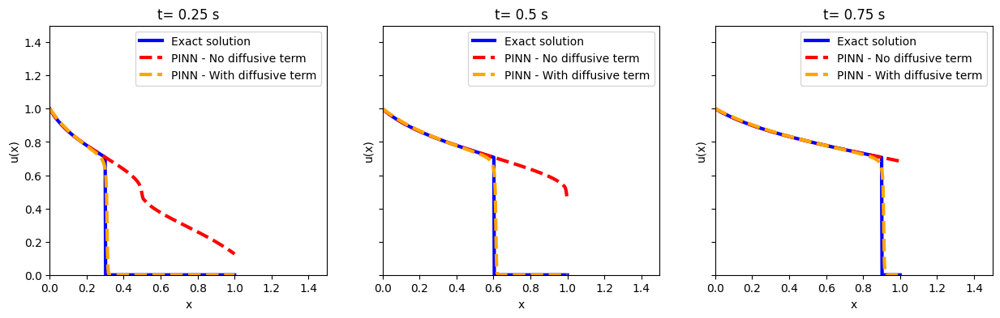

In [20]:
# Plots the chart of PINN with and without diffusion term together with the
# analytical solution


fig, axs = plt.subplots(1, 3, sharey=True,  figsize=(15, 4))

t_especific = [0.25, 0.5,0.75]

index = int(t_especific[0]/dt)
axs[0].plot(np.linspace(0,1,nx), u_n[index],color='blue' , ls='-', lw=3, label="Exact solution")
axs[0].plot(x_plot,  u_n_pinn[index], color='red', ls='--', lw=3,  label="PINN - No diffusive term")
axs[0].plot(x_plot,  u_n_pinn_diffusive[index], color='orange', ls='--', lw=3,  label="PINN - With diffusive term")

axs[0].set_title("t= " + str(t_especific[0]) + " s")
axs[0].set_ylim(0,1.5)
axs[0].set_xlim(0,1.5)
axs[0].legend()


index = int(t_especific[1]/dt)
axs[1].set_title("t= " + str(t_especific[1]) + " s")
axs[1].plot(np.linspace(0,1,nx), u_n[index],color='blue' , ls='-', lw=3, label="Exact solution")
axs[1].plot(x_plot,  u_n_pinn[index], color='red', ls='--', lw=3,  label="PINN - No diffusive term")
axs[1].plot(x_plot,  u_n_pinn_diffusive[index], color='orange', ls='--', lw=3,  label="PINN - With diffusive term")


axs[1].legend()
axs[1].set_ylim(0,1.5)
axs[1].set_xlim(0,1.5)

index = int(t_especific[2]/dt)
axs[2].set_title("t= " + str(t_especific[2]) + " s")
axs[2].plot(np.linspace(0,1,nx), u_n[index],color='blue' , ls='-', lw=3, label="Exact solution")
axs[2].plot(x_plot,  u_n_pinn[index], color='red', ls='--', lw=3,  label="PINN - No diffusive term")
axs[2].plot(x_plot,  u_n_pinn_diffusive[index], color='orange', ls='--', lw=3,  label="PINN - With diffusive term")


axs[2].legend()
axs[2].set_ylim(0,1.5)
axs[2].set_xlim(0,1.5)

for ax in axs.flat:
    ax.set(xlabel='x', ylabel='u(x)')

plt.show()

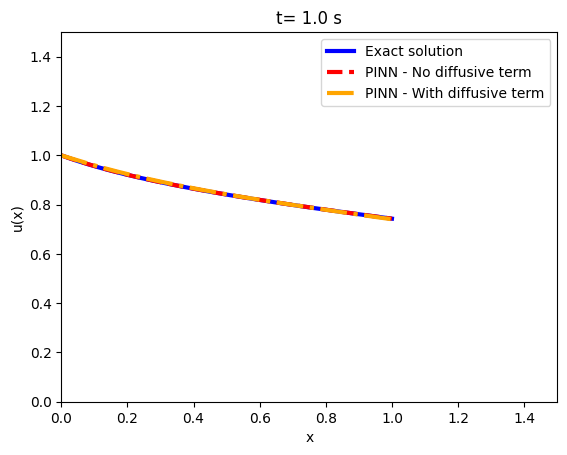

In [21]:
fig = plt.figure()
ax = plt.axes(xlim=(0.0,1.5),ylim=(0.0,1.5),xlabel=('x'),ylabel=('u(x)'))
line = ax.plot([], [], color='blue', ls='-', lw=3, label="Exact solution")[0]
line2 = ax.plot([], [], color='red', ls='--', lw=3, label="PINN - No diffusive term")[0]
line3 = ax.plot([], [], color='orange', ls='dashdot', lw=3, label="PINN - With diffusive term")[0]


def init():
    line.set_data([], [])
    line2.set_data([], [])
    line3.set_data([], [])
    return line, line2, line3

def animate(i):
    x = np.linspace(0.0,1,nx)
    y = u_n[i,:].copy()
    y2 = u_n_pinn[i,:].copy()
    y3 = u_n_pinn_diffusive[i,:].copy()
    line.set_data(x,y)   
    line2.set_data(x,y2)   
    line3.set_data(x,y3)   
    plt.title("t= " + str(round(i*dt,2)) + " s")
    plt.legend()
    return line,line2, line3
    
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=nt, interval=100, blit=True)
#display_animation(anim, default_mode="once")

rc('animation', html='jshtml')
anim

Error analysis in network prediction using the test set.

In [22]:
x_eval = (np.random.rand(N) * x_max)[:, None]
time_eval = (np.random.rand(N) * T_max)[:, None]

In [23]:
# Analysis on the test set

#Exact solution
u_exact = np.zeros(N)
i=0
for x,t in zip(x_eval, time_eval):
    u_exact[i]= u_analytic(x,t)
    i=i+1

In [24]:
# PINNs Solution

u_approximated_eval = net.eval(input_data=np.hstack([x_eval, time_eval]))
u_approximated_eval_diffusive = net_diffusive.eval(input_data=np.hstack([x_eval, time_eval]))


In [25]:
# Root Mean Square Error

error_pinn = np.sqrt(np.mean((u_approximated_eval.flatten()-u_exact)**2))

error_pinn_diffusive = np.sqrt(np.mean((u_approximated_eval_diffusive.flatten()-u_exact)**2))


print("The RMSE of the PINN without diffusive term was: ", error_pinn)
print("The RMSE of the PINN with diffusive term was: ", error_pinn_diffusive)


The RMSE of the PINN without diffusive term was:  0.2994384331929834
The RMSE of the PINN with diffusive term was:  0.04058853654096998


**Tensorboard**


The cells below are responsible for running the tensorboard for analyzing the evolution of the _losses_ of pde, int and bound.

In [26]:
# Load the TensorBoard notebook extension
import tensorflow as tf

%load_ext tensorboard

In [27]:
%tensorboard --logdir=./runs

<IPython.core.display.Javascript object>